#Bibliotecas e medição do tempo de execução

In [ ]:
from time import time #Medir  tempo de execução
import numpy as np #Auxiliar na construção de funções e gráficos
import matplotlib.pyplot as plt #Plotar gráficos
from mpl_toolkits.mplot3d import Axes3D #Plotar em 3D
import plotly.graph_objects as go #Plotar gráficos interativos
import random #Gerar números randicos
from matplotlib import animation #Gerar animações


In [ ]:
#Para medir  temo de execução dos algritmos será utilizado ese código
start_time = time()
end_time = time()
elapsed_time = end_time - start_time
print(f"Elapsed time: {elapsed_time} seconds")

#Otimização Local com Hill Climbing

##Visualizar a superfície da função em 3D

###Função

In [ ]:
def f(x,y):
  return (x**2) + (y**2) + 25*((np.sin(x))**2 + (np.sin(y)**2))

###Gráficos da função

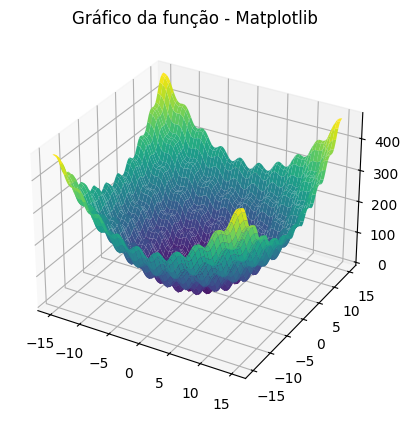

<Figure size 1000x1000 with 0 Axes>

In [ ]:
# Create a grid of x and y values
x = np.linspace(-15, 15, 1000)
y = np.linspace(-15, 15, 1000)
X, Y = np.meshgrid(x, y)
Z = f(X,Y)

# Plot using matplotlib
fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')
ax.plot_surface(X, Y, Z, cmap='viridis')
ax.set_title('Gráfico da função - Matplotlib')
plt.figure(figsize=(10, 10))
plt.show()

In [ ]:
# Create a grid of x and y values
x = np.linspace(-5, 5, 100)
y = np.linspace(-5, 5, 100)
X, Y = np.meshgrid(x, y)
Z = f(X,Y)

# Plot using plotly
fig = go.Figure(data=[go.Surface(z=Z, x=X, y=Y, colorscale='Viridis')])
fig.update_layout(title='Gráfico da função - Plotly')
fig.show()

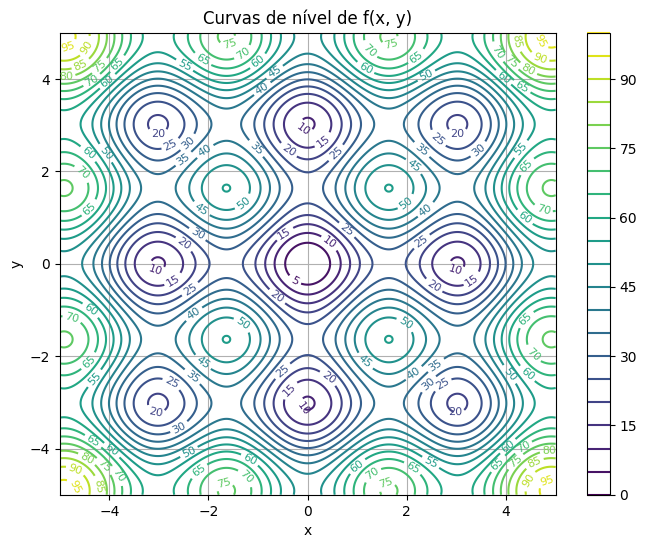

In [ ]:

# Create a grid
x = np.linspace(-5, 5, 400)
y = np.linspace(-5, 5, 400)
X, Y = np.meshgrid(x, y)
Z = f(X, Y)

# Plot level curves
plt.figure(figsize=(8, 6))
contours = plt.contour(X, Y, Z, levels=20, cmap='viridis')
plt.clabel(contours, inline=True, fontsize=8)
plt.title('Curvas de nível de f(x, y)')
plt.xlabel('x')
plt.ylabel('y')
plt.grid(True)
plt.colorbar(contours)
plt.show()


In [ ]:

# Plotly Contour Plot
fig = go.Figure(data=go.Contour(
    z=Z,
    x=x,  # x-axis values
    y=y,  # y-axis values
    contours=dict(
        coloring='heatmap',
        showlabels=True,
        labelfont=dict(size=12, color='white')
    ),
    colorbar=dict(title='f(x, y)')
))

fig.update_layout(
    title='Curvas de nível de f(x, y)',
    xaxis_title='x',
    yaxis_title='y'
)

fig.show()


**Conclusões**

A função não possui máximos globais e possui vários máximos e mínimos locais e nunca é negativa pois todos os termos são positivos, assim ela é sempre maior ou igual a zero.  Ela possui um único mínimo global em (0,0) cujo valor é 0.

##Hill Climbing  - versão básica

###Introdução

O algoritmo Hill Climbing é utilizado para maximizar ou minimizar uma função. Para isso busca os picos ou vales. Funcionando da seguinte maneira para minimizar:

1.   Inicia por um ponto aleatório
2.   Calcula o valor da função no ponto e nos pontos vizinhos
3.   Move para o ponto com o menor valor
4.   Repete passos 2 e 3 até não ocorrer mais aumento da função

**Caracteerísticas**

*   Guloso: Não há possibilidade de mudar para um valor maior
*   Risco de cair em mínimos locais
*   Não retorna a estados anteriores






###Implementação da função Hill Climbing

A função Hill Climbing recebe como parâmetros a função, as coordenadas iniciais - escolhidas aleatoriamente - o incremento e o número máximo de iterações.

Como a função tem 2 dimensões, o número de vizinhos de cada ponto passam a ser 8, estes coincidem com as direções da rosa dos ventos: Norte, Sul, Leste, Oeste, Nordeste, Noroeeste, Suldeste, Suldoeste.

O valor da função é calculada para o ponto e todos os vizinhos e para próxima iteração é escolhido o ponto de maior valor, caso seja o mesmo da iteração anterior o algoritmo para e retorna ele e seu valor.

In [ ]:
# Hill Climbing in 2D with path tracking
def hill_climb_2d_with_path(f, x_start, y_start, step_size=0.1, max_iter=1000):
    x, y = x_start, y_start
    path = [(x, y, f(x, y))]  # store visited points

    for k in range(1, max_iter):
        current = f(x, y)

        # 8 neighboring directions
        neighbors = [
            (x + step_size, y),
            (x - step_size, y),
            (x, y + step_size),
            (x, y - step_size),
            (x + step_size, y + step_size),
            (x - step_size, y - step_size),
            (x + step_size, y - step_size),
            (x - step_size, y + step_size)
        ]

        # Find the best neighbor
        best_neighbor = (x, y)
        best_value = current
        for xn, yn in neighbors:
            val = f(xn, yn)
            if val < best_value:
                best_value = val
                best_neighbor = (xn, yn)

        if best_neighbor == (x, y):
            break  # no improvement
        else:
            x, y = best_neighbor
            path.append((x, y, f(x, y)))  # save new point

    return x, y, f(x, y), path, k

###Exemplos

####Inicio (x, y): (0.2436, 1.1216)

In [ ]:
# Start from a random point
start_time = time()
x_start = random.uniform(-5, 5)
y_start = random.uniform(-5, 5)
x_best, y_best, z_best, path, iter = hill_climb_2d_with_path(f, x_start, y_start)
end_time = time()
elapsed_time = end_time - start_time
print(f"Elapsed time: {elapsed_time} seconds")
print(f"Inicio (x, y): ({x_start:.4f}, {y_start:.4f})")
print(f"Melhor (x, y): ({x_best:.4f}, {y_best:.4f})")
print(f"Número de iterações: {iter}")
print(f"Menor valor: {z_best:.4f}")

Elapsed time: 0.0006470680236816406 seconds
Inicio (x, y): (0.2436, 1.1216)
Melhor (x, y): (0.0436, 0.0216)
Número de iterações: 12
Menor valor: 0.0615


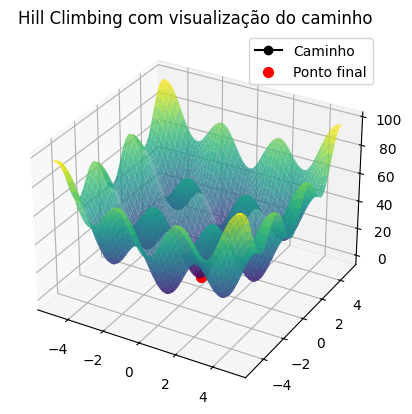

In [ ]:
# Prepare surface plot
fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')

X = np.linspace(-5, 5, 100)
Y = np.linspace(-5, 5, 100)
X, Y = np.meshgrid(X, Y)
Z = f(X, Y)

# Plot the surface
ax.plot_surface(X, Y, Z, cmap='viridis', alpha=0.8)

# Extract path arrays
x_path = [pt[0] for pt in path]
y_path = [pt[1] for pt in path]
z_path = [pt[2] for pt in path]

# Plot the path
ax.plot(x_path, y_path, z_path, color='black', marker='o', label='Caminho')
ax.scatter(x_best, y_best, z_best, color='red', s=50, label='Ponto final')
ax.set_title('Hill Climbing com visualização do caminho')
ax.legend()

plt.show()

In [ ]:
# Plotly surface
surface = go.Surface(z=Z, x=X, y=Y, colorscale='Viridis', opacity=0.8)

# Path as line
path_trace = go.Scatter3d(
    x=x_path, y=y_path, z=z_path,
    mode='lines+markers',
    line=dict(color='red', width=4),
    marker=dict(size=4, color='red'),
    name='Caminho'
)

# Final point
final_point = go.Scatter3d(
    x=[x_best], y=[y_best], z=[z_best],
    mode='markers',
    marker=dict(size=6, color='white'),
    name='Melhor ponto'
)

# Create figure
fig = go.Figure(data=[surface, path_trace, final_point])
fig.update_layout(
    title='Hill Climbing com visualização do caminho (Plotly)',
    scene=dict(
        xaxis_title='X',
        yaxis_title='Y',
        zaxis_title='f(x, y)'
    )
)

fig.show()


####Inicio (x, y): (1.1617, -4.6163)


In [ ]:
# Start from a random point
start_time = time()
x_start = random.uniform(-5, 5)
y_start = random.uniform(-5, 5)
x_best, y_best, z_best, path, iter = hill_climb_2d_with_path(f, x_start, y_start)
end_time = time()
elapsed_time = end_time - start_time
print(f"Elapsed time: {elapsed_time} seconds")
print(f"Inicio (x, y): ({x_start:.4f}, {y_start:.4f})")
print(f"Melhor (x, y): ({x_best:.4f}, {y_best:.4f})")
print(f"Número de iterações: {iter}")
print(f"Menor valor: {z_best:.4f}")

Elapsed time: 0.0007598400115966797 seconds
Inicio (x, y): (1.1617, -4.6163)
Melhor (x, y): (-0.0383, -3.0163)
Número de iterações: 17
Menor valor: 9.5267


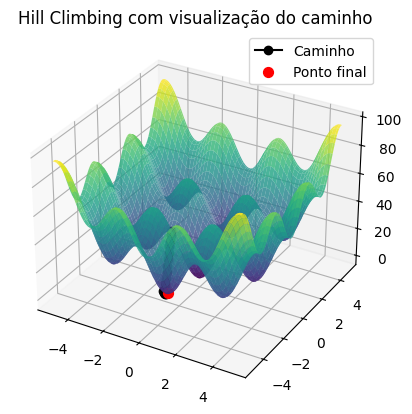

In [ ]:
# Prepare surface plot
fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')

X = np.linspace(-5, 5, 100)
Y = np.linspace(-5, 5, 100)
X, Y = np.meshgrid(X, Y)
Z = f(X, Y)

# Plot the surface
ax.plot_surface(X, Y, Z, cmap='viridis', alpha=0.8)

# Extract path arrays
x_path = [pt[0] for pt in path]
y_path = [pt[1] for pt in path]
z_path = [pt[2] for pt in path]

# Plot the path
ax.plot(x_path, y_path, z_path, color='black', marker='o', label='Caminho')
ax.scatter(x_best, y_best, z_best, color='red', s=50, label='Ponto final')
ax.set_title('Hill Climbing com visualização do caminho')
ax.legend()

plt.show()

In [ ]:
# Plotly surface
surface = go.Surface(z=Z, x=X, y=Y, colorscale='Viridis', opacity=0.8)

# Path as line
path_trace = go.Scatter3d(
    x=x_path, y=y_path, z=z_path,
    mode='lines+markers',
    line=dict(color='red', width=4),
    marker=dict(size=4, color='red'),
    name='Caminho'
)

# Final point
final_point = go.Scatter3d(
    x=[x_best], y=[y_best], z=[z_best],
    mode='markers',
    marker=dict(size=6, color='white'),
    name='Melhor ponto'
)

# Create figure
fig = go.Figure(data=[surface, path_trace, final_point])
fig.update_layout(
    title='Hill Climbing com visualização do caminho (Plotly)',
    scene=dict(
        xaxis_title='X',
        yaxis_title='Y',
        zaxis_title='f(x, y)'
    )
)

fig.show()


####Inicio (x, y): (-0.8610, -0.1302)


In [ ]:
# Start from a random point
start_time = time()
x_start = random.uniform(-5, 5)
y_start = random.uniform(-5, 5)
x_best, y_best, z_best, path, iter = hill_climb_2d_with_path(f, x_start, y_start)
end_time = time()
elapsed_time = end_time - start_time
print(f"Elapsed time: {elapsed_time} seconds")
print(f"Inicio (x, y): ({x_start:.4f}, {y_start:.4f})")
print(f"Melhor (x, y): ({x_best:.4f}, {y_best:.4f})")
print(f"Número de iterações: {iter}")
print(f"Menor valor: {z_best:.4f}")

Elapsed time: 0.0005369186401367188 seconds
Inicio (x, y): (-0.8610, -0.1302)
Melhor (x, y): (0.0390, -0.0302)
Número de iterações: 10
Menor valor: 0.0633


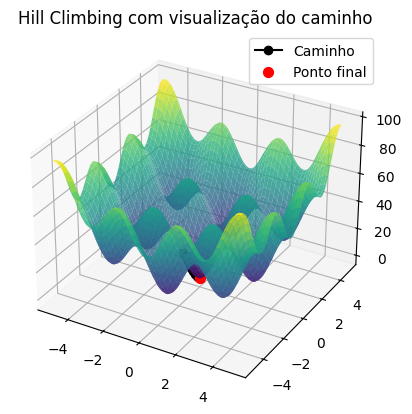

In [ ]:
# Prepare surface plot
fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')

X = np.linspace(-5, 5, 100)
Y = np.linspace(-5, 5, 100)
X, Y = np.meshgrid(X, Y)
Z = f(X, Y)

# Plot the surface
ax.plot_surface(X, Y, Z, cmap='viridis', alpha=0.8)

# Extract path arrays
x_path = [pt[0] for pt in path]
y_path = [pt[1] for pt in path]
z_path = [pt[2] for pt in path]

# Plot the path
ax.plot(x_path, y_path, z_path, color='black', marker='o', label='Caminho')
ax.scatter(x_best, y_best, z_best, color='red', s=50, label='Ponto final')
ax.set_title('Hill Climbing com visualização do caminho')
ax.legend()

plt.show()

In [ ]:
# Plotly surface
surface = go.Surface(z=Z, x=X, y=Y, colorscale='Viridis', opacity=0.8)

# Path as line
path_trace = go.Scatter3d(
    x=x_path, y=y_path, z=z_path,
    mode='lines+markers',
    line=dict(color='red', width=4),
    marker=dict(size=4, color='red'),
    name='Caminho'
)

# Final point
final_point = go.Scatter3d(
    x=[x_best], y=[y_best], z=[z_best],
    mode='markers',
    marker=dict(size=6, color='white'),
    name='Melhor ponto'
)

# Create figure
fig = go.Figure(data=[surface, path_trace, final_point])
fig.update_layout(
    title='Hill Climbing com visualização do caminho (Plotly)',
    scene=dict(
        xaxis_title='X',
        yaxis_title='Y',
        zaxis_title='f(x, y)'
    )
)

fig.show()


###Conclusões


Dependendo de o quão perto o ponto inicial esteja do mínimo global, o valor pode se aproximar bastante desse valor. Em geral, as soluções ficaram em mínimos locais. O número de iteerações foi inferior a 20 nos exemplos. Os tempos de execução ficaram abaixo de 1ms.

##Hill Climbing - random restarts

###Introdução

Nessa abordagem a função aplicada calculada para vários pontos iniciais. Ela tem a vantagem de diminuir as chances de ficar presa em um máximo ou mínimo local

###Implementação da Hill Climbimg com random restarts

Essa função chama a função da implementação básica para vários pontos iniciais aleatórios, compara os resutados e pega o melhor deles. Ela retorna o melhor ponto e o caminho.

In [ ]:
def hill_climb_with_restarts(f, restarts=10, step_size=0.1, max_iter=1000):
    best_solution = None
    best_value = float('inf')
    best_path = []

    for _ in range(restarts):
        x_start = random.uniform(-5, 5)
        y_start = random.uniform(-5, 5)
        x, y, val, path, k = hill_climb_2d_with_path(f, x_start, y_start, step_size, max_iter)

        if val < best_value:
            best_solution = (x, y, val, k)
            best_value = val
            best_path = path

    return best_solution, best_path


###Exemplos

####Melhor ponto (x, y): (0.0103, -0.0125)


In [ ]:
start_time = time()
best_solution, best_path = hill_climb_with_restarts(f, restarts=20)
end_time = time()
elapsed_time = end_time - start_time
print(f"Elapsed time: {elapsed_time} seconds")
print(f"Melhor ponto (x, y): ({best_solution[0]:.4f}, {best_solution[1]:.4f})")
print(f"Valor mínimo: {best_solution[2]:.4f}")
print(f"Número de iterações: {best_solution[3]}")

Elapsed time: 0.008745908737182617 seconds
Melhor ponto (x, y): (0.0103, -0.0125)
Valor mínimo: 0.0068
Número de iterações: 16


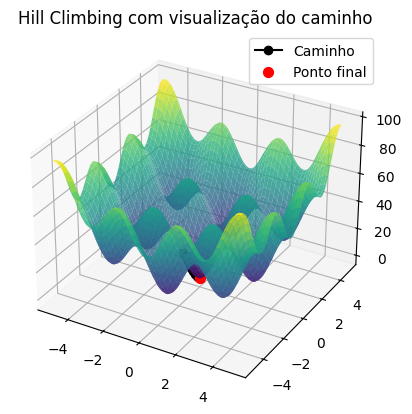

In [ ]:
# Prepare surface plot
fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')

X = np.linspace(-5, 5, 100)
Y = np.linspace(-5, 5, 100)
X, Y = np.meshgrid(X, Y)
Z = f(X, Y)

# Plot the surface
ax.plot_surface(X, Y, Z, cmap='viridis', alpha=0.8)

# Extract path arrays
x_path = [pt[0] for pt in path]
y_path = [pt[1] for pt in path]
z_path = [pt[2] for pt in path]

# Plot the path
ax.plot(x_path, y_path, z_path, color='black', marker='o', label='Caminho')
ax.scatter(x_best, y_best, z_best, color='red', s=50, label='Ponto final')
ax.set_title('Hill Climbing com visualização do caminho')
ax.legend()

plt.show()

In [ ]:
# Plotly surface
surface = go.Surface(z=Z, x=X, y=Y, colorscale='Viridis', opacity=0.8)

# Path as line
path_trace = go.Scatter3d(
    x=x_path, y=y_path, z=z_path,
    mode='lines+markers',
    line=dict(color='red', width=4),
    marker=dict(size=4, color='red'),
    name='Caminho'
)

# Final point
final_point = go.Scatter3d(
    x=[x_best], y=[y_best], z=[z_best],
    mode='markers',
    marker=dict(size=6, color='white'),
    name='Melhor ponto'
)

# Create figure
fig = go.Figure(data=[surface, path_trace, final_point])
fig.update_layout(
    title='Hill Climbing com visualização do caminho (Plotly)',
    scene=dict(
        xaxis_title='X',
        yaxis_title='Y',
        zaxis_title='f(x, y)'
    )
)

fig.show()


####Melhor ponto (x, y): (-0.0058, -3.0151)


In [ ]:
start_time = time()
best_solution, best_path = hill_climb_with_restarts(f, restarts=20)
end_time = time()
elapsed_time = end_time - start_time
print(f"Elapsed time: {elapsed_time} seconds")
print(f"Melhor ponto (x, y): ({best_solution[0]:.4f}, {best_solution[1]:.4f})")
print(f"Valor mínimo: {best_solution[2]:.4f}")
print(f"Número de iterações: {best_solution[3]}")

Elapsed time: 0.01463174819946289 seconds
Melhor ponto (x, y): (-0.0058, -3.0151)
Valor mínimo: 9.4896
Número de iterações: 9


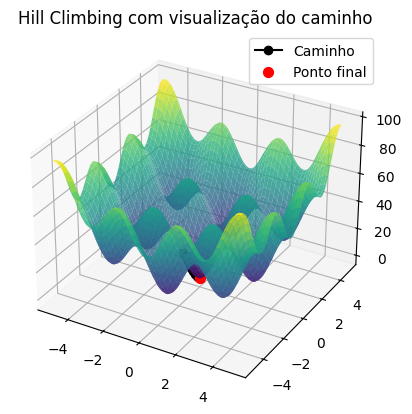

In [ ]:
# Prepare surface plot
fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')

X = np.linspace(-5, 5, 100)
Y = np.linspace(-5, 5, 100)
X, Y = np.meshgrid(X, Y)
Z = f(X, Y)

# Plot the surface
ax.plot_surface(X, Y, Z, cmap='viridis', alpha=0.8)

# Extract path arrays
x_path = [pt[0] for pt in path]
y_path = [pt[1] for pt in path]
z_path = [pt[2] for pt in path]

# Plot the path
ax.plot(x_path, y_path, z_path, color='black', marker='o', label='Caminho')
ax.scatter(x_best, y_best, z_best, color='red', s=50, label='Ponto final')
ax.set_title('Hill Climbing com visualização do caminho')
ax.legend()

plt.show()

In [ ]:
# Plotly surface
surface = go.Surface(z=Z, x=X, y=Y, colorscale='Viridis', opacity=0.8)

# Path as line
path_trace = go.Scatter3d(
    x=x_path, y=y_path, z=z_path,
    mode='lines+markers',
    line=dict(color='red', width=4),
    marker=dict(size=4, color='red'),
    name='Caminho'
)

# Final point
final_point = go.Scatter3d(
    x=[x_best], y=[y_best], z=[z_best],
    mode='markers',
    marker=dict(size=6, color='white'),
    name='Melhor ponto'
)

# Create figure
fig = go.Figure(data=[surface, path_trace, final_point])
fig.update_layout(
    title='Hill Climbing com visualização do caminho (Plotly)',
    scene=dict(
        xaxis_title='X',
        yaxis_title='Y',
        zaxis_title='f(x, y)'
    )
)

fig.show()


####Melhor ponto (x, y): (-0.0254, -0.0036)


In [ ]:
start_time = time()
best_solution, best_path = hill_climb_with_restarts(f, restarts=20)
end_time = time()
elapsed_time = end_time - start_time
print(f"Elapsed time: {elapsed_time} seconds")
print(f"Melhor ponto (x, y): ({best_solution[0]:.4f}, {best_solution[1]:.4f})")
print(f"Valor mínimo: {best_solution[2]:.4f}")
print(f"Número de iterações: {best_solution[3]}")

Elapsed time: 0.01805424690246582 seconds
Melhor ponto (x, y): (-0.0254, -0.0036)
Valor mínimo: 0.0172
Número de iterações: 9


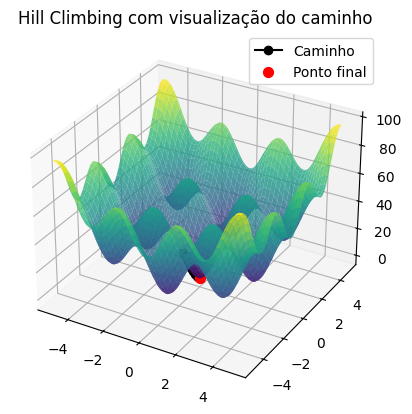

In [ ]:
# Prepare surface plot
fig = plt.figure()
ax = fig.add_subplot(111, projection='3d')

X = np.linspace(-5, 5, 100)
Y = np.linspace(-5, 5, 100)
X, Y = np.meshgrid(X, Y)
Z = f(X, Y)

# Plot the surface
ax.plot_surface(X, Y, Z, cmap='viridis', alpha=0.8)

# Extract path arrays
x_path = [pt[0] for pt in path]
y_path = [pt[1] for pt in path]
z_path = [pt[2] for pt in path]

# Plot the path
ax.plot(x_path, y_path, z_path, color='black', marker='o', label='Caminho')
ax.scatter(x_best, y_best, z_best, color='red', s=50, label='Ponto final')
ax.set_title('Hill Climbing com visualização do caminho')
ax.legend()

plt.show()

In [ ]:
# Plotly surface
surface = go.Surface(z=Z, x=X, y=Y, colorscale='Viridis', opacity=0.8)

# Path as line
path_trace = go.Scatter3d(
    x=x_path, y=y_path, z=z_path,
    mode='lines+markers',
    line=dict(color='red', width=4),
    marker=dict(size=4, color='red'),
    name='Caminho'
)

# Final point
final_point = go.Scatter3d(
    x=[x_best], y=[y_best], z=[z_best],
    mode='markers',
    marker=dict(size=6, color='white'),
    name='Melhor ponto'
)

# Create figure
fig = go.Figure(data=[surface, path_trace, final_point])
fig.update_layout(
    title='Hill Climbing com visualização do caminho (Plotly)',
    scene=dict(
        xaxis_title='X',
        yaxis_title='Y',
        zaxis_title='f(x, y)'
    )
)

fig.show()


###Implementação da Hill Climbimg com random restarts e visualização dos caminhos

Agora cada caminho dos pontos escolhidos é armazenado na lista all_paths e é retornado ao final, nos permitindo ver os vários trajetos.

In [ ]:
# Hill climbing with random restarts (all paths collected)
def hill_climb_with_restarts_all_paths(f, restarts=5, step_size=0.1, max_iter=1000):
    all_paths = []
    best_solution = None
    best_value = float('inf')
    best_path = []

    for _ in range(restarts):
        x_start = random.uniform(-5, 5)
        y_start = random.uniform(-5, 5)
        x, y, val, path,  k = hill_climb_2d_with_path(f, x_start, y_start, step_size, max_iter)
        all_paths.append(path)

        if val < best_value:
            best_value = val
            best_solution = (x, y, val, k)
            best_path = path

    return best_solution, best_path, all_paths

In [ ]:
start_time = time()
best_solution, best_path, all_paths = hill_climb_with_restarts_all_paths(f)
end_time = time()
elapsed_time = end_time - start_time
print(f"Elapsed time: {elapsed_time} seconds")
print(f"Melhor ponto (x, y): ({best_solution[0]:.4f}, {best_solution[1]:.4f})")
print(f"Valor mínimo: {best_solution[2]:.4f}")
print(f"Número de iterações: {best_solution[3]}")

Elapsed time: 0.0020685195922851562 seconds
Melhor ponto (x, y): (0.0412, 0.0226)
Valor mínimo: 0.0575
Número de iterações: 12


In [ ]:
# Generate surface grid
x = np.linspace(-5, 5, 100)
y = np.linspace(-5, 5, 100)
X, Y = np.meshgrid(x, y)
Z = f(X, Y)

# Base surface plot
surface = go.Surface(z=Z, x=X, y=Y, colorscale='Viridis', opacity=0.7)

# Prepare animation frames
frames = []
frame_num = 0

for restart_index, path in enumerate(all_paths):
    for i in range(1, len(path)+1):
        x_path = [p[0] for p in path[:i]]
        y_path = [p[1] for p in path[:i]]
        z_path = [p[2] for p in path[:i]]

        frames.append(go.Frame(
            data=[
                surface,
                go.Scatter3d(x=x_path, y=y_path, z=z_path,
                             mode='lines+markers',
                             line=dict(color='red', width=4),
                             marker=dict(size=4, color='black'),
                             name=f'Path {restart_index+1}'),
                go.Scatter3d(x=[best_solution[0]], y=[best_solution[1]], z=[best_solution[2]],
                             mode='markers', marker=dict(size=6, color='blue'),
                             name='Best')
            ],
            name=f'frame{frame_num}'
        ))
        frame_num += 1

# Initial plot (empty path)
fig = go.Figure(
    data=[
        surface,
        go.Scatter3d(x=[], y=[], z=[], mode='lines+markers',
                     line=dict(color='red', width=4), marker=dict(size=4, color='black')),
        go.Scatter3d(x=[best_solution[0]], y=[best_solution[1]], z=[best_solution[2]],
                     mode='markers', marker=dict(size=6, color='blue'))
    ],
    layout=go.Layout(
        title='Hill Climbing with Random Restarts (Plotly Animation)',
        scene=dict(
            xaxis_title='X',
            yaxis_title='Y',
            zaxis_title='f(x, y)'
        ),
        updatemenus=[dict(
            type="buttons",
            showactive=False,
            buttons=[dict(label="Play",
                          method="animate",
                          args=[None, {"frame": {"duration": 300, "redraw": True},
                                       "fromcurrent": True, "transition": {"duration": 100}}])]
        )]
    ),
    frames=frames
)

fig.show()

###Conclusões

Os tempos de execução foram entre 6ms a 18ms. Com o número maior de reinicios, esta versão tem maior potencial de se aproximar no mínimo global. Como foi visto pelos gráfico das curvas de nível, o grande número de minimos locais dificultam encontrar o mínimo global